In [10]:
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import folium
from collections import Counter
import re

## EDA

## Base Question 1: What are the end-to-end travel times for different bus routes?

To address the research question, our team initiated a preliminary investigation to identify suitable datasets related to MBTA Bus Routes and travel times. Subsequent research led us to discover a dataset containing bus arrival and departure events. We proceeded to download and meticulously analyze this dataset, determining that it contained sufficient data to effectively address the initial and secondary research inquiries.

Since we knew the timeframe focus of this project was January 1, 2022 - January 31, 2022 (mentioned in the overview document), we specifically downloaded the [MBTA Bus Arrival Departure Times 2022](https://mbta-massdot.opendata.arcgis.com/datasets/mbta-bus-arrival-departure-times-2022/about).

In [8]:
!ls ../../../../Downloads/MBTA_Bus_Arrival_Departure_Times_2022

MBTA-Bus-Arrival-Departure-Times_2022-01.csv
MBTA-Bus-Arrival-Departure-Times_2022-02.csv
MBTA-Bus-Arrival-Departure-Times_2022-03.csv
MBTA-Bus-Arrival-Departure-Times_2022-04.csv
MBTA-Bus-Arrival-Departure-Times_2022-05.csv
MBTA-Bus-Arrival-Departure-Times_2022-06.csv
MBTA-Bus-Arrival-Departure-Times_2022-07.csv
MBTA-Bus-Arrival-Departure-Times_2022-08.csv
MBTA-Bus-Arrival-Departure-Times_2022-09.csv
MBTA-Bus-Arrival-Departure-Times_2022-10.csv
MBTA-Bus-Arrival-Departure-Times_2022-11.csv
MBTA-Bus-Arrival-Departure-Times_2022-12.csv


In [11]:
q1_file_path = "../../../../Downloads/MBTA_Bus_Arrival_Departure_Times_2022/MBTA-Bus-Arrival-Departure-Times_2022-01.csv" # 1 denoting January 2022
df = pd.read_csv(q1_file_path)

We performed basic EDA on the dataset.

In [12]:
df.shape

(2348823, 13)

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2348823 entries, 0 to 2348822
Data columns (total 13 columns):
 #   Column             Dtype  
---  ------             -----  
 0   service_date       object 
 1   route_id           object 
 2   direction_id       object 
 3   half_trip_id       float64
 4   stop_id            int64  
 5   time_point_id      object 
 6   time_point_order   int64  
 7   point_type         object 
 8   standard_type      object 
 9   scheduled          object 
 10  actual             object 
 11  scheduled_headway  float64
 12  headway            float64
dtypes: float64(3), int64(2), object(8)
memory usage: 233.0+ MB


In [13]:
# Checking if there are any duplicate data in our dataset
df.duplicated().sum()

0

In [14]:
# Checking if there are any null values in our dataset
df.isnull().sum()

service_date               0
route_id                   0
direction_id               0
half_trip_id             213
stop_id                    0
time_point_id              0
time_point_order           0
point_type                 0
standard_type              0
scheduled                  0
actual                180264
scheduled_headway    1196318
headway              1418416
dtype: int64

To work with the time data, we decided to convert our `scheduled` and `actual` data column to a pandas datetime object, making comparisons and operations much more easier to work with.

0          1900-01-01 06:05:00.000
1          1900-01-01 06:09:00.000
2          1900-01-01 06:12:00.000
3          1900-01-01 06:15:00.000
4          1900-01-01 06:19:00.000
                    ...           
2348818    1900-01-02 01:07:00.000
2348819    1900-01-02 01:11:00.000
2348820    1900-01-02 01:13:00.000
2348821    1900-01-02 01:16:00.000
2348822    1900-01-02 01:21:00.000
Name: scheduled, Length: 2348823, dtype: object

In [11]:
df['scheduled'] = pd.to_datetime(df['scheduled'])
df['actual'] = pd.to_datetime(df['actual'])

Knowing that we have data from January 1 to January 31 of 2022, we decided to find the inbound and outbound travel times for each date as weekday, weekend, or holiday travel times could differ.

We created a helper function that does the necessary operations to group the routes together and find the raw, average, and median end-to-end times of each route's inbound and outbound times.

In [22]:
def process_end_to_end_time(date):
    date_pattern = r'^\d{4}-\d{2}-\d{2}$'
    if not re.match(date_pattern, date):
        raise "Incorrect input."
        
    # Get schedules of given date
    df_type_schedule = df[df["standard_type"] == "Schedule"]
    # df_type_schedule = df_type_schedule[df_type_schedule["service_date"] == "2022-01-03"]
    df_type_schedule = df_type_schedule[df_type_schedule["service_date"] == date]

    # Filter by startpoint and endpoint
    df_start_end = df_type_schedule[(df_type_schedule["point_type"] == "Startpoint") | (df_type_schedule["point_type"] == "Endpoint")]

    # Filter for "Startpoint" and "Endpoint" entries
    startpoints = df[df["point_type"] == "Startpoint"]
    endpoints = df[df["point_type"] == "Endpoint"]
    
    # Group Startpoints and Endpoints by 'half_trip_id'
    startpoint_groups = startpoints.groupby("half_trip_id")
    endpoint_groups = endpoints.groupby("half_trip_id")
    
    # Calculate the end-to-end travel time for each 'half_trip_id'
    end_to_end_travel_times = (endpoint_groups["actual"].max() - startpoint_groups["actual"].min()).dt.total_seconds() / 60
    
    # Merge 'half_trip_id' and 'end-to-end travel times' into a new DataFrame
    end_to_end_df = pd.DataFrame({'half_trip_id': end_to_end_travel_times.index, 'end_to_end_travel_time': end_to_end_travel_times.values})
    
    # Extract the start and end times for each 'half_trip_id'
    start_times = startpoint_groups["actual"].min()
    end_times = endpoint_groups["actual"].max()
    
    # Add the start and end times to the 'end_to_end_df'
    end_to_end_df["start_time"] = start_times.loc[end_to_end_df["half_trip_id"].values].values
    end_to_end_df["end_time"] = end_times.loc[end_to_end_df["half_trip_id"].values].values
    
    # Merge the 'route_id' and 'direction_id' from the original DataFrame
    end_to_end_df = end_to_end_df.merge(df[['half_trip_id', 'route_id', 'direction_id']], on='half_trip_id', how='left')
    
    # Reorder the columns for better readability
    end_to_end_df = end_to_end_df[['half_trip_id', 'route_id', 'direction_id', 'start_time', 'end_time', 'end_to_end_travel_time']]

    unique_end_to_end = end_to_end_df.groupby(['half_trip_id', 'route_id', 'direction_id'], as_index=False).agg({
        'start_time': 'first',
        'end_time': 'first',
        'end_to_end_travel_time': 'mean'
    })

    unique_end_to_end = unique_end_to_end.dropna()
    output_file_path = f'./data/question-1/processed/raw/{date}.csv'  # Replace with your desired file path
    unique_end_to_end.to_csv(output_file_path, index=False)

    mean_end_to_end = unique_end_to_end.groupby(['route_id', 'direction_id'], as_index=False)['end_to_end_travel_time'].mean()
    output_file_path = f'./data/question-1/processed/avg/{date}.csv'  # Replace with your desired file path
    mean_end_to_end.to_csv(output_file_path, index=False)
        
    median_end_to_end = unique_end_to_end.groupby(['route_id', 'direction_id'], as_index=False)['end_to_end_travel_time'].median()
    output_file_path = f'./data/question-1/processed/median/{date}.csv'  # Replace with your desired file path
    median_end_to_end.to_csv(output_file_path, index=False)

In [23]:
process_end_to_end_time("2022-01-01")

Here is an example of the raw, average and median end-to-end travel times of each route.

In [24]:
df_jan1 = pd.read_csv("./data/question-1/processed/raw/2022-01-01.csv")
df_jan1_avg = pd.read_csv("./data/question-1/processed/avg/2022-01-01.csv")
df_jan1_median = pd.read_csv("./data/question-1/processed/median/2022-01-01.csv")

In [25]:
df_jan1.head()

,half_trip_id,route_id,direction_id,start_time,end_time,end_to_end_travel_time
0,54136531.0,21,Outbound,1900-01-01 20:03:18,1900-01-01 20:15:58,12.666667
1,54136532.0,26,Inbound,1900-01-01 20:25:55,1900-01-01 20:36:01,10.100000
2,54136533.0,26,Outbound,1900-01-01 20:36:33,1900-01-01 20:45:40,9.116667
3,54136534.0,21,Inbound,1900-01-01 20:58:19,1900-01-01 21:12:12,13.883333
4,54136535.0,42,Inbound,1900-01-01 21:27:30,1900-01-01 21:38:00,10.500000


In [26]:
df_jan1_avg.head()

,route_id,direction_id,end_to_end_travel_time
0,01,Inbound,30.473510
1,01,Outbound,30.899495
2,04,Inbound,25.630918
3,04,Outbound,18.729442
4,07,Inbound,14.421404


In [27]:
df_jan1_median.head()

,route_id,direction_id,end_to_end_travel_time
0,01,Inbound,30.108333
1,01,Outbound,30.533333
2,04,Inbound,21.850000
3,04,Outbound,16.266667
4,07,Inbound,14.266667


In [23]:
df_jan2 = pd.read_csv("./data/question-1/processed/raw/2022-01-02.csv")
df_jan2_avg = pd.read_csv("./data/question-1/processed/avg/2022-01-02.csv")
df_jan2_median = pd.read_csv("./data/question-1/processed/median/2022-01-02.csv")

df_jan2.head()

,half_trip_id,route_id,direction_id,start_time,end_time,end_to_end_travel_time
0,54136531.0,21,Outbound,1900-01-01 20:03:18,1900-01-01 20:15:58,12.666667
1,54136532.0,26,Inbound,1900-01-01 20:25:55,1900-01-01 20:36:01,10.100000
2,54136533.0,26,Outbound,1900-01-01 20:36:33,1900-01-01 20:45:40,9.116667
3,54136534.0,21,Inbound,1900-01-01 20:58:19,1900-01-01 21:12:12,13.883333
4,54136535.0,42,Inbound,1900-01-01 21:27:30,1900-01-01 21:38:00,10.500000


Then, we proceeded to generate the processed data for each day in January.

In [28]:
for day in range(1, 32):
    # Format the day as a two-digit string
    formatted_day = f"{day:02}"

    # Create the date string with the formatted day
    date = f"2022-01-{formatted_day}"

    # Call your function with the date
    process_end_to_end_time(date)

#### Data Visualizations:

In [52]:
!ls data

gdf = gpd.read_file('data/MBTA_Systemwide_GTFS_Map/MBTA_Systemwide_GTFS_Map.shp')
neighborhood_boundaries_gdf = gpd.read_file('data/Census2020_BG_Neighborhoods/Census2020_BG_Neighborhoods.shp')

2020_Census_Tracts_in_Boston question-2
Census2020_BG_Neighborhoods  routes.csv
MBTA_Systemwide_GTFS_Map     stops.csv
endpointTime.csv             temp.txt
question-1


In [57]:
neighborhood_boundaries_gdf.head()

,OBJECTID,BlockGr202,Shape_Leng,Shape_Area,geometry
0,1,Allston,35808.619278,4.154760e+07,"POLYGON ((-71.12123 42.36775, -71.12069 42.367..."
1,2,Back Bay,18815.103609,1.538724e+07,"POLYGON ((-71.07315 42.35554, -71.07302 42.355..."
2,3,Beacon Hill,11668.951169,7.891524e+06,"POLYGON ((-71.06291 42.36123, -71.06286 42.360..."
3,4,Brighton,47051.804654,7.658156e+07,"POLYGON ((-71.13737 42.35876, -71.13747 42.358..."
4,5,Charlestown,33910.754786,5.127021e+07,"POLYGON ((-71.06700 42.39401, -71.06741 42.393..."


In [54]:
import pyproj


map = folium.Map(location=[42.320, -71.05], zoom_start=12, min_zoom=12)

common_crs = pyproj.CRS.from_epsg(4326) 

neighborhood_coordinates = {
    "Allston": (42.3539, -71.1333),
    "East Boston": (42.3702, -71.0389),
    "North End": (42.3651, -71.0546),
    "Back Bay": (42.3505, -71.0760),
    "Fenway": (42.3429, -71.1003),
    "Roslindale": (42.2912, -71.1241),
    "Beacon Hill": (42.3588, -71.0707),
    "Roxbury": (42.3248, -71.0955),
    "Brighton": (42.3501, -71.1564),
    "Hyde Park": (42.2557, -71.1245),
    "South Boston": (42.3381, -71.0476),
    "Charlestown": (42.3756, -71.0651),
    "Jamaica Plain": (42.3097, -71.1151),
    "South Boston Waterfront": (42.3536, -71.0509),
    "Chinatown": (42.3525, -71.0612),
    "Longwood": (42.3377, -71.1026),
    "South End": (42.3400, -71.0737),
    "Dorchester": (42.3016, -71.0675),
    "Mattapan": (42.2775, -71.0914),
    "West End": (42.3646, -71.0674),
    "Downtown": (42.3601, -71.0589),
    "Mission Hill": (42.3322, -71.1032),
    "West Roxbury": (42.2798, -71.1628)
}

# Set or reproject the CRS to the common one
neighborhood_boundaries_gdf = neighborhood_boundaries_gdf.to_crs(common_crs)

bus_routes_geojson_data = gdf.to_json()
neighborhood_boundaries_geojson = neighborhood_boundaries_gdf.to_json()
folium.GeoJson(bus_routes_geojson_data).add_to(map)
folium.GeoJson(neighborhood_boundaries_geojson).add_to(map)

map

#### Now let's merge the shapefile with the data. Since the shapefile doesn't have separate lines for outbounds and inbounds, we're going to create two separate maps.

In [25]:
# Separate Inbound and Outbound Data into Two Dataframes
inbound_df = df_jan2_avg[df_jan2_avg['direction_id'] == 'Inbound']
outbound_df = df_jan2_avg[df_jan2_avg['direction_id'] == 'Outbound']

# Merge both with the GeoDataFrame

inbound_gdf = gdf.merge(inbound_df, on='route_id')
outbound_gdf = gdf.merge(outbound_df, on='route_id')

In [26]:
# Let's add a style function to better understand the range of all end-to-end travel times.

def map_color(travel_time):
    # Define the color gradient (you can adjust this to your preference)
    min_color = (0, 255, 0)  # Green for low travel times
    max_color = (255, 0, 0)  # Red for high travel times

    # Map the travel time to a color within the gradient
    normalized_travel_time = (travel_time - inbound_df['end_to_end_travel_time'].min()) / (inbound_df['end_to_end_travel_time'].max() - inbound_df['end_to_end_travel_time'].min())
    color = tuple(int(min_c + (max_c - min_c) * normalized_travel_time) for min_c, max_c in zip(min_color, max_color))

    # Return the color as a hexadecimal string
    return "#{:02X}{:02X}{:02X}".format(*color)

def style_function(feature):
    end_to_end_travel_time = feature['properties']['end_to_end_travel_time']
    color = map_color(end_to_end_travel_time)
    return {
        'color': color,
        'weight': 3
    }

### Inbound End-To-End-Travel Time

In [58]:
map = folium.Map(location=[42.320, -71.05], zoom_start=12, min_zoom=11)
inbound_geojson_data = inbound_gdf.to_json()
folium.GeoJson(neighborhood_boundaries_geojson).add_to(map)
folium.GeoJson(inbound_geojson_data, style_function=style_function).add_to(map)
map

In [56]:
map = folium.Map(location=[42.320, -71.05], zoom_start=12, min_zoom=11)
outbound_geojson_data = outbound_gdf.to_json()
folium.GeoJson(outbound_geojson_data, style_function=style_function).add_to(map)
folium.GeoJson(neighborhood_boundaries_geojson).add_to(map)
map

### This visualization can be a bit confusing, so we can use matplotlib instead to plot the census map, and plot the bus routes on top of it.

In [30]:
# Download the 2020 Census Data
census_data = pd.read_csv('https://data.boston.gov/dataset/7846ff3b-b738-47a3-a57e-19de2c753220/resource/013aba13-5985-4067-bba4-a8d3ca9a34ac/download/census-tract-data.csv')
census_data.head()

,FILEID,STUSAB,SUMLEV,GEOID,GEOCODE,REGION,DIVISION,STATE,COUNTY,COUSUB,...,P0050004,P0050005,P0050006,P0050007,P0050008,P0050009,P0050010,H0010001,H0010002,H0010003
0,field concept,State/US-Abbreviation (USPS),Summary Level,Geographic Record Identifier,Geographic Code Identifier,Region,Division,State (FIPS),County (FIPS),County Subdivision (FIPS),...,Juvenile facilities,Nursing facilities/Skilled-nursing facilities,Other institutional facilities,Noninstitutionalized population:,College/University student housing,Military quarters,Other noninstitutional facilities,Total:,Occupied,Vacant
1,PLST,MA,140,1400000US25025000101,25025000101,1,1,25,25,NaN,...,0,0,0,10,0,0,10,726,697,29
2,PLST,MA,140,1400000US25025000102,25025000102,1,1,25,25,NaN,...,7,0,0,10,0,0,10,1695,1606,89
3,PLST,MA,140,1400000US25025000201,25025000201,1,1,25,25,NaN,...,6,0,0,39,0,0,39,1608,1544,64
4,PLST,MA,140,1400000US25025000202,25025000202,1,1,25,25,NaN,...,0,0,0,41,0,0,41,1606,1539,67


In [31]:
# Drop unneeded columns
drop_columns = ['FILEID', 'STUSAB', 'SUMLEV', 'GEOID', 'REGION', 'DIVISION', 'STATE', 'COUNTY', 'COUSUB']
census_data = census_data.drop(columns=drop_columns, axis=1)
census_data.head()

,GEOCODE,TRACT,P0020001,P0020005,P0020006,P0020002,P0020008,P0020007,P0020009,P0020010,...,P0050004,P0050005,P0050006,P0050007,P0050008,P0050009,P0050010,H0010001,H0010002,H0010003
0,Geographic Code Identifier,Census Tract,Total:,White alone,Black or African American alone,Hispanic or Latino,Asian alone,American Indian and Alaska Native alone,Native Hawaiian and Other Pacific Islander alone,Some Other Race alone,...,Juvenile facilities,Nursing facilities/Skilled-nursing facilities,Other institutional facilities,Noninstitutionalized population:,College/University student housing,Military quarters,Other noninstitutional facilities,Total:,Occupied,Vacant
1,25025000101,101,1876,1211,83,183,274,7,0,39,...,0,0,0,10,0,0,10,726,697,29
2,25025000102,102,3714,1565,298,554,883,8,2,177,...,7,0,0,10,0,0,10,1695,1606,89
3,25025000201,201,3953,2712,138,422,421,1,0,101,...,6,0,0,39,0,0,39,1608,1544,64
4,25025000202,202,4148,2394,221,778,536,1,0,64,...,0,0,0,41,0,0,41,1606,1539,67


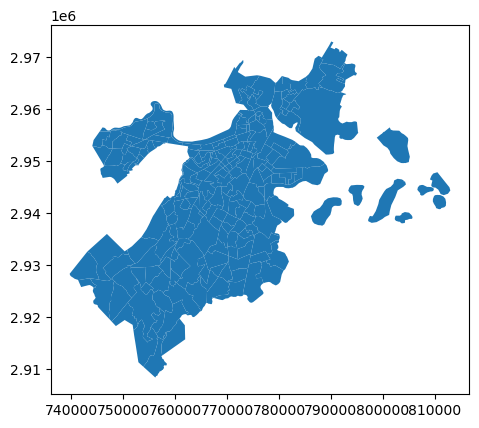

In [46]:
census_gdf = gpd.read_file('data/2020_Census_Tracts_in_Boston/2020_Census_Tracts_in_Boston.shp')
census_gdf.head()

neighborhood_coordinates = {
    "Allston": (42.3539, -71.1333),
    "East Boston": (42.3702, -71.0389),
    "North End": (42.3651, -71.0546),
    "Back Bay": (42.3505, -71.0760),
    "Fenway": (42.3429, -71.1003),
    "Roslindale": (42.2912, -71.1241),
    "Beacon Hill": (42.3588, -71.0707),
    "Roxbury": (42.3248, -71.0955),
    "Brighton": (42.3501, -71.1564),
    "Hyde Park": (42.2557, -71.1245),
    "South Boston": (42.3381, -71.0476),
    "Charlestown": (42.3756, -71.0651),
    "Jamaica Plain": (42.3097, -71.1151),
    "South Boston Waterfront": (42.3536, -71.0509),
    "Chinatown": (42.3525, -71.0612),
    "Longwood": (42.3377, -71.1026),
    "South End": (42.3400, -71.0737),
    "Dorchester": (42.3016, -71.0675),
    "Mattapan": (42.2775, -71.0914),
    "West End": (42.3646, -71.0674),
    "Downtown": (42.3601, -71.0589),
    "Mission Hill": (42.3322, -71.1032),
    "West Roxbury": (42.2798, -71.1628)
}
ax = census_gdf.plot()

for neighborhood, coordinates in neighborhood_coordinates.items():
    plt.annotate(neighborhood, xy=coordinates, xytext=(3,3), textcoords='offset points')

plt.show()

In [44]:
merged_gdf = census_gdf.merge(census_data.iloc[1:, :], left_on='geoid20', right_on='GEOCODE')
merged_gdf.head()

,geoid20,countyfp20,namelsad20,statefp20,tractce20,intptlat20,name20,funcstat20,intptlon20,mtfcc20,...,P0050004,P0050005,P0050006,P0050007,P0050008,P0050009,P0050010,H0010001,H0010002,H0010003
0,25025140202,025,Census Tract,25,140202,+42.2495181,1402.02,S,-071.1175430,G5020,...,0,31,0,80,64,0,16,2204,2115,89
1,25025140300,025,Census Tract,25,140300,+42.2587734,1403,S,-071.1188131,G5020,...,0,36,0,16,0,0,16,2644,2517,127
2,25025140400,025,Census Tract,25,140400,+42.2692219,1404,S,-071.1118088,G5020,...,0,0,0,1,0,0,1,2971,2831,140
3,25025140106,025,Census Tract,25,140106,+42.2738738,1401.06,S,-071.1371416,G5020,...,0,0,0,0,0,0,0,973,922,51
4,25025110201,025,Census Tract,25,110201,+42.2804960,1102.01,S,-071.1170508,G5020,...,0,0,0,23,0,0,23,851,809,42


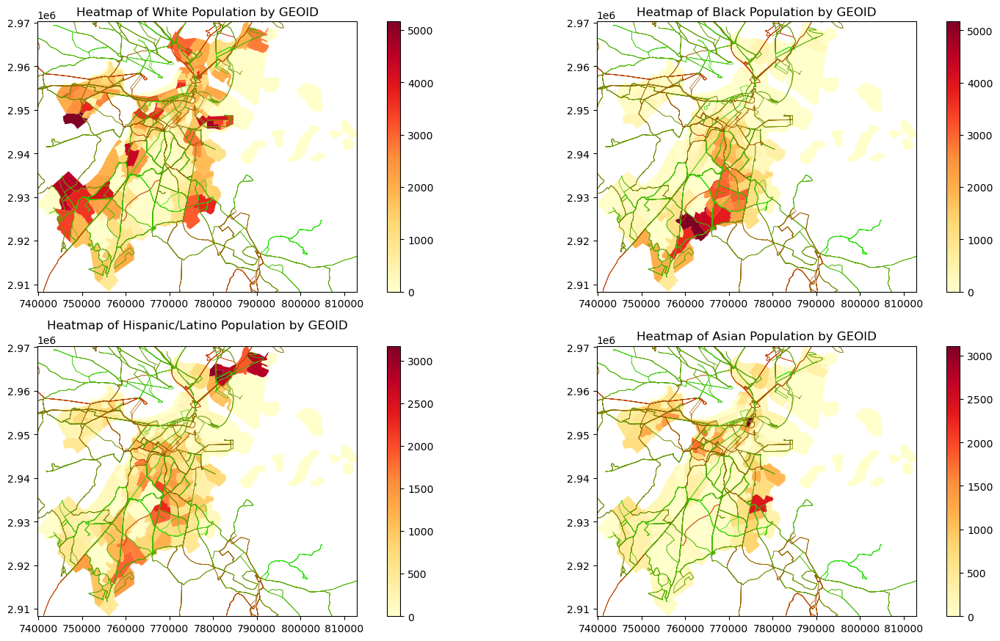

In [42]:
fig, axs = plt.subplots(2, 2, figsize=(16, 9))

# Define bounds because shapefile for bus routes exceeds past Boston
x_min, y_min, x_max, y_max = merged_gdf.total_bounds

for i in range(2):
    for j in range(2):
        ax = axs[i, j]
        ax.set_xlim(x_min, x_max)
        ax.set_ylim(y_min, y_max)

# Census Code for White, Black, Hispanic / Latino, Asian (in order)
columns_to_numeric = ['P0020005', 'P0020006', 'P0020002', 'P0020008']
for col, ax in zip(columns_to_numeric, axs.flat):
    merged_gdf[col] = pd.to_numeric(merged_gdf[col], errors='coerce')
    merged_gdf.plot(column=col, cmap='YlOrRd', legend=True, ax=ax)

# Create a color map for each bus route and replace original 'route_colo' value
# The original author made a spelling mistake so its called 'route_colo', not 'route_color'

unique_route_ids = inbound_gdf['route_id'].unique()
color_mapping = {route_id: map_color(inbound_gdf.loc[inbound_gdf['route_id'] == route_id, 'end_to_end_travel_time'].values[0]) for i, route_id in enumerate(unique_route_ids)}
inbound_gdf['route_colo'] = inbound_gdf['route_id'].map(color_mapping)

for i in range(2):
    for j in range(2):
        ax = axs[i, j]
        inbound_gdf.to_crs(merged_gdf.crs).plot(ax=ax, linewidth=0.5, color=inbound_gdf['route_colo'])

titles = ["White Population", "Black Population", "Hispanic/Latino Population", "Asian Population"]
for i, ax in enumerate(axs.flat):
    ax.set_title(f"Heatmap of {titles[i]} by GEOID")

plt.tight_layout()
plt.show()